In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pylab as plt
import matplotlib.colors as colors
import matplotlib.patches as patches
import torchvision
import matplotlib.patches as patches
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D

import os
import time
import torch
import sys
import argparse
sys.path.insert(0, '../../shared_code')
from model_loader_func import * 
from dataloader_func import *
from quality_metrics_func import *
from linear_approx import *
from inverse_tasks_func import synthesis
from plotting_func import *
from algorithm_inv_prob import * 
from trainer import make_loader
%matplotlib inline

In [2]:
print(torch.__version__)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

2.5.0+cu124


device(type='cuda')

# functions 

In [3]:
## plotting stuff: 
noise_colormap = plt.cm.copper 
scale_colormap = plt.cm.seismic


In [4]:
similarity_matrix = lambda data : data/data.norm(dim = 1, keepdim=True) @(data/data.norm(dim = 1, keepdim=True)).T
similarity_vactor = lambda data, v : (v/(v.norm(dim = 1, keepdim=True)+1e-6) @(data/(data.norm(dim = 1, keepdim=True) +1e-6 ) ).T).flatten()
similarity_matrix_2mats = lambda data1, data2 : data1/data1.norm(dim = 1, keepdim=True) @(data2/data2.norm(dim = 1, keepdim=True)).T

degree_matrix = lambda sim_mat : torch.diag(sim_mat.sum(dim = 1))

participation_ratio = lambda v :  (v.norm(1)**2)/v.norm(2)**2/len(v)
participation_ratio_dataset = lambda data :  (data.norm(1, dim = 1)**2)/data.norm(2,dim = 1)**2/data.shape[1]


# Load denoisers 

In [5]:
denoisers = {}

root_path = '/mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/'

paths = {  
            'mixture-color-deep-no-skip': 'UNet_flex/bedroom/0to255_RF_84x84_set_size_299718_color_no_skip_deep_dec_80x80/',
                # 'mixture-gray-face': 'UNet_flex/img_align_bedroom/0to255_RF_84x84_set_size_201498/'
        }

groups = paths.keys()


for group in groups: 
    path = root_path + paths[group]
    
    print('loading group ' , group )
    if 'modified' in group.split('-'):
        new_arch = 'UNet_conditional_mean_matching'
    else: 
        new_arch = None
    denoisers[group] = load_learned_model(path, print_args=True, new_arch=new_arch)
    start_time_total = time.time()        
    print("--- %s seconds ---" % (round(time.time() - start_time_total)))
     

loading group  mixture-color-deep-no-skip
*************** saved arguments:*************
arch_name UNet_flex
lr 0.001
batch_size 2048
num_epochs 1500
lr_freq 100
loss_weight False
noise_level_range [0, 255]
quadratic_noise True
rescale False
swap False
set_size 299718
imagenet_subset_ids None
data_name bedroom
data_root_path /mnt/home/zkadkhodaie/ceph/datasets/
dir_name /mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/UNet_flex/bedroom/0to255_RF_84x84_set_size_299718_color_no_skip_deep_dec_l1_penalty_80x80
optional_dir_label color_no_skip_deep_dec_l1_penalty
device cuda
debug False
kernel_size 3
padding 1
skip False
num_channels 3
bias True
RF 84
coarse True
self_cond False
num_kernels [64, 128, 256, 512]
num_blocks 3
num_enc_conv [2, 2, 2]
num_mid_conv 3
num_dec_conv [6, 6, 6]
NormType LayerNorm
inter_skip True
dilations None
upsample_with_bias False
sparsify_phi False
lambda_l1 None
******************************************************
number of parameters is  

In [6]:
denoisers.keys()

dict_keys(['mixture-color-deep-no-skip'])

In [7]:
layers = {}
for group in groups:
    layers[group] = []
    for i in range(len(denoisers[group].encoder)):
        layers[group].append(denoisers[group].encoder[str(i) ][0].weight.shape[0])
    
    layers[group].append(denoisers[group].mid[0].weight.shape[0])
    
    for i in range(len(denoisers[group].decoder)-1 , 0, -1):
        layers[group].append(denoisers[group].decoder[str(i) ][0].weight.shape[0])


layers

{'mixture-color-deep-no-skip': [64, 128, 256, 512, 256, 128]}

In [8]:
block_names = {}
for group in groups: 
    block_names[group] = []
    for l in range(int(len(layers[group])/2)): 
        block_names[group].append('enc' + str(l))
    block_names[group].append('mid'  )        
    for l in range(int(len(layers[group])/2)-1, 0,-1):
        block_names[group].append('dec' + str(l) )
block_names   

{'mixture-color-deep-no-skip': ['enc0', 'enc1', 'enc2', 'mid', 'dec2', 'dec1']}

# Load datasets 

In [9]:
train_sets = {}
test_sets = {}

data = torch.load( '/mnt/home/zkadkhodaie/ceph/datasets/' + 'bedroom' +'/train_color_80x80.pt', weights_only=True)    


train_sets = data[0:-100]    
test_sets = data[-100::]



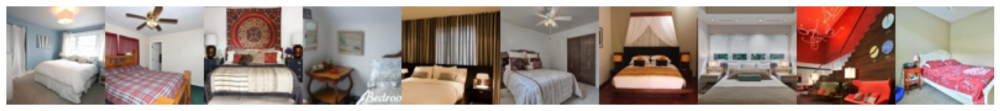

In [10]:
show_im_grid(test_sets[0:10] )


In [11]:
K = test_sets.shape[2]
n_channels = test_sets.shape[1]
print(len(test_sets))

100


tensor(0.5364)


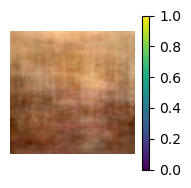

In [12]:
dist_mean = (test_sets).mean(dim = (0))
plot_single_im(dist_mean, colorbar=True)
print(dist_mean.mean())

In [13]:
dist_mean.mean(dim = (1,2), keepdim = True)

tensor([[[0.5942]],

        [[0.5313]],

        [[0.4835]]])

In [14]:
test_sets_cat = test_sets
test_sets_cat.shape

torch.Size([100, 3, 80, 80])

#  Noise dependence of $\phi$

## 1.1) What is the variance of $\phi_{\sigma}(y)$ at a given $\sigma$ (Variance due to noise realization stochasticity)

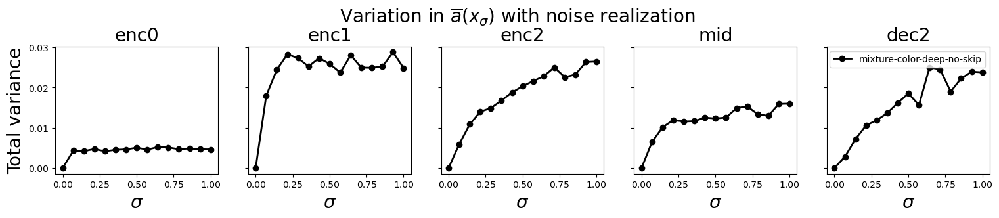

In [16]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1,len(groups))]

f, axs = plt.subplots(1,5, figsize = (15,3), sharey=True, sharex=True)
f.suptitle('Variation in $\overline{a}(x_{\sigma})$ with noise realization', fontsize = 20)
# 
plt.tight_layout()
i = 0
for group in groups:
    # group = 'mixture-color'
    
    sigmas = torch.linspace(0,1, 15)
    
    ids = torch.randint(0, test_sets_cat.shape[0], size = (1,))
    all_phis = []
    for sig in sigmas:
        all_phis.append(phi_c_many_noise(denoisers[group], test_sets_cat[ids], sigs=torch.ones(len(ids),1,1,1) * sig , n_noise= 10 ))
        
    
    ### plot 

    keep_delta = 0
    for b in range(1,6):
        out = torch.stack([all_phis[i][b] for i in range(len(all_phis)) ])
    
        total_var = []
        for j in range(len(sigmas)): 
            U, S, Vh = torch.svd(torch.cov(out[j,:,0,:].T))    
            total_var.append(S.sum().sqrt().cpu())
        
        axs[b-1].plot(sigmas, total_var, '-o',
                         lw = 2,color=plot_colors[i], label = group)
        
        
        axs[b-1].set_xlabel('$\sigma$', fontsize = 20)    
        axs[b-1].set_title(block_names[group][b-1],fontsize = 20)
    
    
    axs[0].set_ylabel('Total variance', fontsize = 20);   
    axs[-1].legend()
    # plt.savefig('../results/unet_phi_noise_realization_dependence.pdf',bbox_inches='tight')    
    i +=1

In [17]:
groups

dict_keys(['mixture-color-deep-no-skip'])

tensor([73])


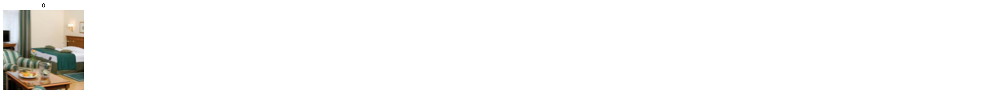

In [18]:
group = 'mixture-color-deep-no-skip'
ids = torch.randint(0,len(test_sets), (1,))
print(ids)
sigmas =np.linspace(0, 250, 5).astype(int)
inp_ims = test_sets[ids]


if 'gray' in group.split('-'): 
    show_im_set(inp_ims.mean(dim = 1, keepdim = True)[0:1],  n_columns=10)
else: 
    show_im_set(inp_ims[0:1],  n_columns=10)
    
inp_ims = torch.tile(inp_ims, (30,1,1,1))


if 'gray' in group.split('-'): 
    inp_ims = inp_ims.mean(dim = 1, keepdim = True)


all_phis  = {}
noise = torch.randn_like(inp_ims)

for sig in sigmas: 
    
    noisy_inp_ims = inp_ims + noise * sig/255
    # phi_xc = get_channel_means(denoisers[group], x1=noisy_inp_ims, x2=None,
                              # average_phi=False,with_params=False , return_activations=False)
    phi_xc = get_activation_means_unconditional(denoisers[group], noisy_inp_ims, noGrad=True)
    
    all_phis[sig] = phi_xc
    

0 participation ratio:  0.16357415914535522 , norm zero:  271.0
62 participation ratio:  0.2867533564567566 , norm zero:  391.0
125 participation ratio:  0.3224128186702728 , norm zero:  435.0
187 participation ratio:  0.3418808877468109 , norm zero:  455.0
250 participation ratio:  0.3482363820075989 , norm zero:  467.0


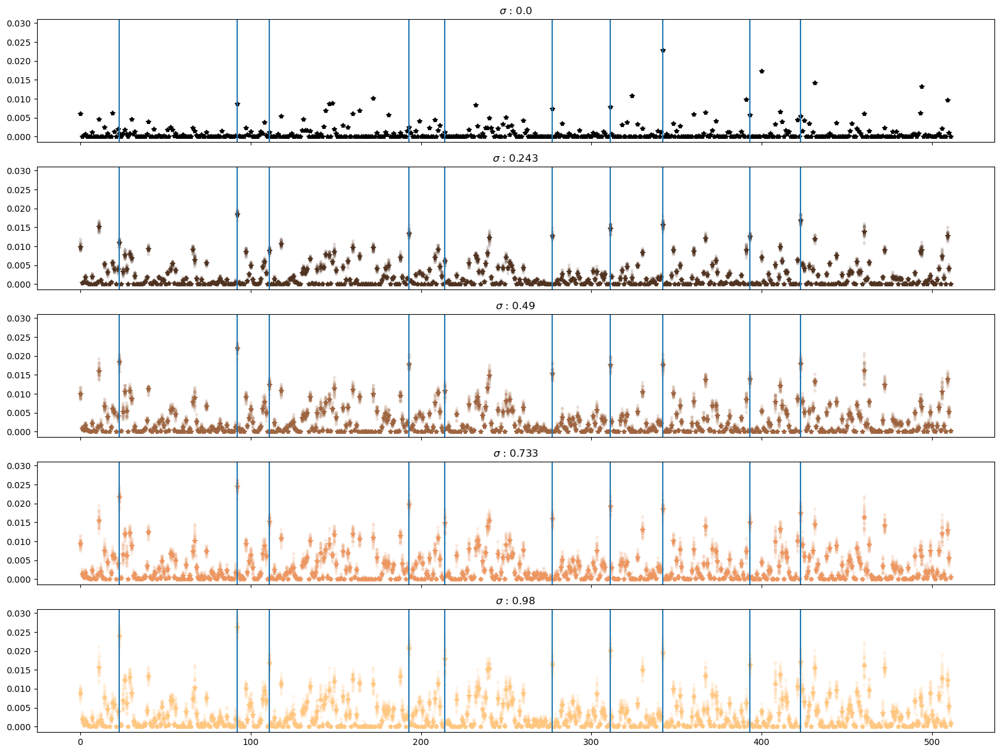

In [19]:
b = 3
f , axs = plt.subplots(len(sigmas),1 ,figsize=(20, len(sigmas)* 3), sharex = True, sharey=True)
colormap = plt.cm.copper 
plot_colors = [colormap(i) for i in np.linspace(0, 1,len(sigmas))]
for j in range(len(sigmas)):
    sig = sigmas[j]
    for i in range(all_phis[sig][b].shape[1]):
        axs[j].plot( torch.ones(all_phis[sig][b].shape[0]) *i , all_phis[sig][b][:, i].cpu().flatten(),  '.-', alpha = .1 , color= plot_colors[j] )
        axs[j].plot( i , all_phis[sig][b][:, i].mean().cpu(),  '*-', alpha = 1, color= plot_colors[j]  )
        axs[j].set_title( '$\sigma$ : ' + str(np.round(sig/255  ,3)))
    for m in range(10):
        axs[j].axvline( all_phis[sigmas[-1]][b].mean(dim = (0)).argsort(descending=True).cpu()[m]  )    
    participation_ratio = (all_phis[sig][b].mean(dim = (0)).norm(1)**2 / all_phis[sig][b].mean(dim = (0)).norm(2)**2 )/all_phis[sig][b].shape[1]
    print(sig , 'participation ratio: ', participation_ratio.item(), ', norm zero: ',all_phis[sig][b].mean(dim = (0)).norm(0).item() )


## 1.2) How does  $\mathbb{E}_z[\phi_{\sigma}(y)]$ change  as a function of noise level $\sigma$

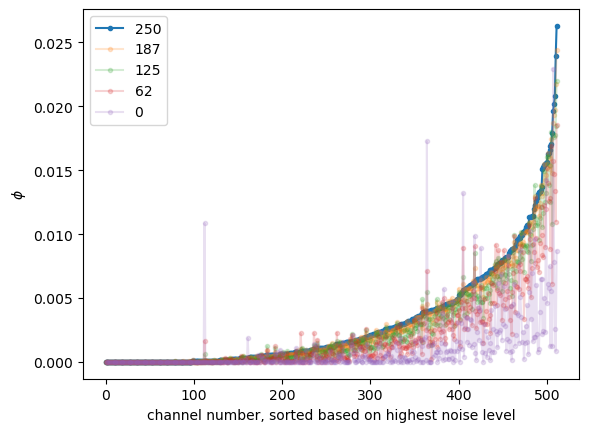

In [20]:
plt.plot(all_phis[sigmas[4]][3].mean(dim = (0)).cpu().sort()[0], '.-',label=sigmas[4])
plt.plot(all_phis[sigmas[3]][3].mean(dim = (0)).cpu()[all_phis[sigmas[4]][3].mean(dim = (0)).cpu().sort()[1]], '.-', alpha = .2,label=sigmas[3])
plt.plot(all_phis[sigmas[2]][3].mean(dim = (0)).cpu()[all_phis[sigmas[4]][3].mean(dim = (0)).cpu().sort()[1]], '.-', alpha = .2,label=sigmas[2])
plt.plot(all_phis[sigmas[1]][3].mean(dim = (0)).cpu()[all_phis[sigmas[4]][3].mean(dim = (0)).cpu().sort()[1]], '.-', alpha = .2,label=sigmas[1])
plt.plot(all_phis[sigmas[0]][3].mean(dim = (0)).cpu()[all_phis[sigmas[4]][3].mean(dim = (0)).cpu().sort()[1]], '.-', alpha = .2,label=sigmas[0])
plt.xlabel('channel number, sorted based on highest noise level')
plt.ylabel(r'$\phi$')
plt.legend()

### Representation becomes more dense at higher noise levels: are the active channels nested across noise levels? 


In [21]:
group = 'mixture-color-deep-no-skip'

sigmas =np.linspace(0, 255, 5).astype(int)
b = 3

all_counts = {}
all_counts_ab = {}
all_counts_ba ={}

for i in range(len(sigmas)-1): 
    all_counts[i] = []
    all_counts_ab[i] = []
    all_counts_ba[i] = []
    
for _ in range(500): 
    
    ids = torch.randint(0,len(test_sets), (1,))
    inp_ims = torch.tile(test_sets[ids], (10,1,1,1))
    
    noise = torch.randn_like(inp_ims)
    
    all_phis  = {}    
    all_sets =[]
    for sig in sigmas: 
        
        noisy_inp_ims = inp_ims + noise * sig/255
        # phi_xc = get_channel_means(denoisers[group], x1=noisy_inp_ims, x2=None,
                                  # average_phi=False,with_params=False , return_activations=False)
        phi_xc = get_activation_means_unconditional(denoisers[group], noisy_inp_ims, noGrad=True)    
        all_phis[sig] = phi_xc
    
    
        stop_id = int(all_phis[sig][b].mean(dim = (0)).norm(1)**2 / all_phis[sig][b].mean(dim = (0)).norm(2)**2 )
        all_sets.append(set((all_phis[sig][b].mean(dim = (0)).argsort(descending=True).cpu()[0:stop_id ]).tolist()))
    
    for i in range(len(all_sets)-1 ): 
        den = (len(all_sets[i]) + len(all_sets[i+1]) )        
        count = len(all_sets[i].symmetric_difference(all_sets[i+1]))
        count_ab=  len(all_sets[i+1] - all_sets[i])
        count_ba = len(all_sets[i] - all_sets[i+1])
        all_counts[i].append(round(100* count / den ))    
        all_counts_ab[i].append(round(100* count_ab / den ))
        all_counts_ba[i].append(round(100* count_ba / den ))


mixture-color-deep-no-skip


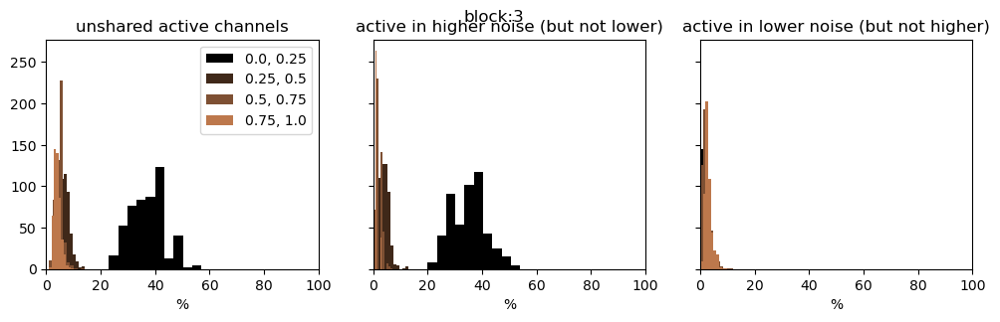

In [22]:
colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1, 6)]

f , axs= plt.subplots(1,3, figsize = (12, 3), sharex=True, sharey=True)
f.suptitle('block:'+ str(b))
for k,v in all_counts.items():
    axs[0].hist(v, color=plot_colors[k], bins=10, alpha = 1, label= f"{round(sigmas[k]/255 ,2)}, {round(sigmas[k+1]/255, 2)}"  )
    axs[0].set_xlim(0,100)
    axs[0].set_title('unshared active channels')
    axs[0].legend()
    axs[0].set_xlabel('%')    
for k,v in all_counts_ab.items():
    axs[1].hist(v, color=plot_colors[k], bins=10, alpha = 1)
    axs[1].set_title('active in higher noise (but not lower)')
    axs[1].set_xlabel('%')
for k,v in all_counts_ba.items():
    axs[2].hist(v, color=plot_colors[k], bins=10, alpha = 1)
    axs[2].set_title('active in lower noise (but not higher)')
    axs[2].set_xlabel('%')
print(group)

### How similar the $\phi$'s at two $\sigma$'s are? 

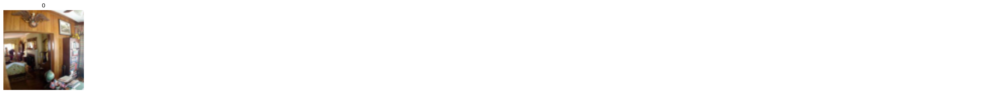

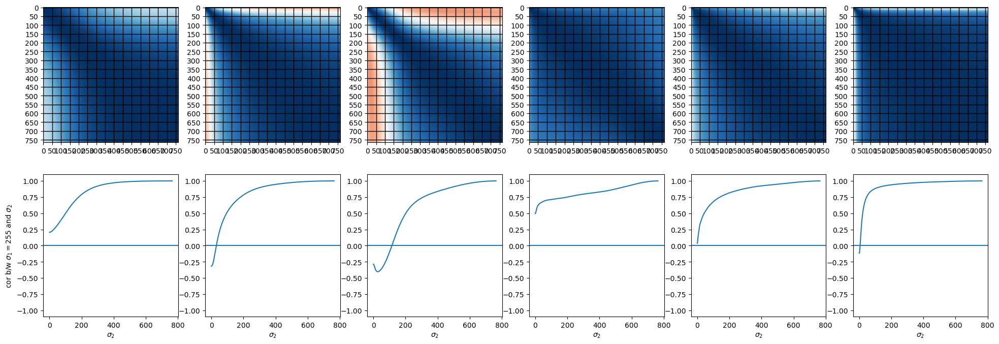

In [23]:
### average response per channel for different images from different classes (instead of pairwise response, we look at responses of many more classes )
ids = torch.randint(0,len(test_sets), (1,))
inp_ims = test_sets[ids]
group = 'mixture-color-deep-no-skip'



if 'gray' in group.split('-'): 
    show_im_set(inp_ims.mean(dim = 1, keepdim = True),  n_columns=10)
else: 
    show_im_set(inp_ims,  n_columns=10)
    
# inp_ims = train['inp'][0:200]
# inp_ims = train_sets[1]

# inp_ims = torch.tile(inp_ims, (20,1,1,1))

if 'gray' in group.split('-'): 
    inp_ims = inp_ims.mean(dim = 1, keepdim = True)

sigmas= range(0,255*3)
# sigmas= torch.logspace(.01,2.4,255)

all_phis  = {}
noise = torch.randn_like(inp_ims)

for sig in sigmas: 
    
    noisy_inp_ims = inp_ims + noise * sig/255
    # phi_xc = get_channel_means(denoisers[group], x1=noisy_inp_ims, x2=None,
                              # average_phi=True,with_params=False , return_activations=False)
    
    phi_xc = get_activation_means_unconditional(denoisers[group], noisy_inp_ims, noGrad=True)
    all_phis[sig] = phi_xc

### plot
f, axs = plt.subplots(2,len(all_phis[sig]), figsize = (24,8))

for b in range( len(all_phis[sig] )):
    temp = torch.corrcoef(torch.stack([all_phis[sig][b].flatten() for sig in sigmas]))

    axs[0,b].imshow(temp.cpu(), 'RdBu',vmin=-1 ,vmax = 1)
    # (all_phis[10][3].flatten() == 0).sum()
    # axs.tick_params(bottom=False,top = False, right = False, left=False)    
    axs[0,b].set_xticks(sigmas[0::50])  ;
    axs[0,b].set_yticks(sigmas[0::50]);
    axs[0,b].grid(color='k', linestyle='-', linewidth=1)
    axs[1,b].plot(temp[-1,:].cpu())
    # axs[1,b].plot(temp[torch.triu(torch.tril(temp, diagonal=1) , diagonal=1) !=0].cpu())    
    axs[1,b].set_ylim(-1.1,1.1)
    axs[1,b].axhline(0)    
    axs[1,b].set_xlabel('$\sigma_2$')    
axs[1,0].set_ylabel('cor b/w $\sigma_1=255$ and $\sigma_2$');    


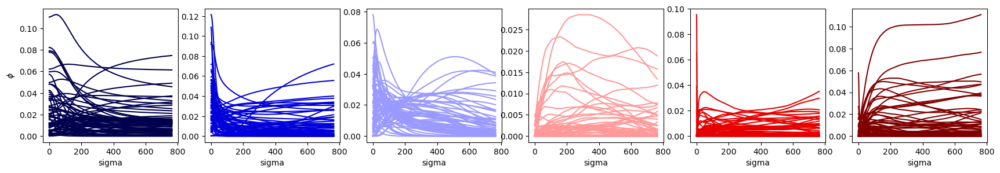

In [24]:
# sc = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [scale_colormap(i) for i in np.linspace(0, 1, 6)]

f, axs = plt.subplots(1,len(phi_xc), figsize=(len(phi_xc)*3.5, 3 ) )
for b in range(len(phi_xc)):
    for i in range(0, phi_xc[0].shape[1] ): 
        axs[b].plot(sigmas, torch.tensor([all_phis[sig][b].mean(dim = 0).squeeze()[i]  for sig in sigmas] ),
                    alpha = 1 , color = plot_colors[b])

    axs[b].set_xlabel('sigma')
    axs[0].set_ylabel('$\phi$')


In [25]:
## for many images 
# noise = torch.randn(1,3,64,64)
ids = torch.randint(0,len(test_sets_cat), (100,))
inp_ims = test_sets_cat[ids]

if 'gray' in group.split('-'): 
    inp_ims = inp_ims.mean(dim = 1, keepdim = True)

sigmas= range(0,3*256, 10)

all_phis  = {}

for sig in sigmas: 
    sigs = (sig/255) * torch.ones(inp_ims.shape[0],1,1,1)
    phi_xc = phi_c_noise_averaged(denoisers[group], x_c=inp_ims, sigs=sigs, n_noise=5 ) 

    # phi_xc = get_channel_means(denoisers[group], x1=noisy_inp_ims, average_phi=False)    
    all_phis[sig] = phi_xc


In [26]:
test_sets_cat.shape

torch.Size([100, 3, 80, 80])

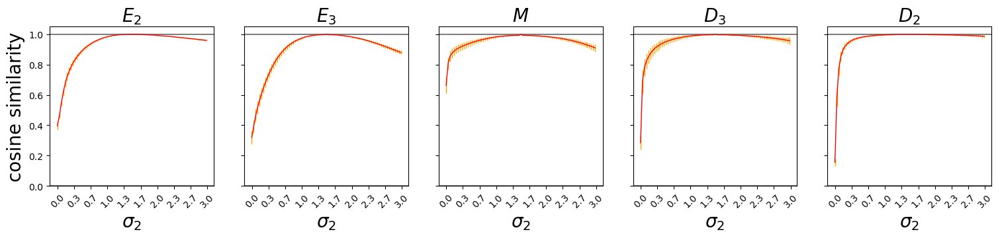

In [27]:


all_corrs = {}
for b in range(1,6):
    temp = torch.stack([all_phis[sig][b].squeeze() for sig in sigmas])
    
    all_corrs[b] = []
    for i in range(len(inp_ims)): 
        # all_corrs[b].append(torch.corrcoef(temp[:,i,:]))
        all_corrs[b].append(similarity_matrix(temp[:,i,:]))
    all_corrs[b] = torch.stack(all_corrs[b])

### plot 
f, axs = plt.subplots(1,len(all_phis[sig])-1, figsize = (15,3), sharey=True, sharex=True)
# f.suptitle('similarity between $\overline{a}(x_{\sigma_1})$ and $\overline{a}(x_{\sigma_2})$ at $\sigma_1=$'+str(round(sigmas[int(all_corrs[b].shape[1]/2)]/255,1))+' and $\sigma_2 \in (0,1)$', 
           # fontsize = 20)
# 
plt.tight_layout()
b_names = ['$E_1$','$E_2$','$E_3$','$M$','$D_3$','$D_2$',]
for b in range(1,6):
    axs[b-1].errorbar(sigmas ,all_corrs[b][:, int(all_corrs[b].shape[1]/2), :].mean(dim = 0).cpu() , 
                      yerr=all_corrs[b][:, int(all_corrs[b].shape[1]/2), :].std(dim = 0).cpu() ,lw=1 ,
                    elinewidth = 1, color='red', ecolor = 'orange' )
    axs[b-1].set_ylim(0,1.05)
    axs[b-1].axhline(0, color='black', alpha = .5)    
    axs[b-1].axhline(1, color='black', alpha = .5)        
    axs[b-1].set_xlabel('$\sigma_2$', fontsize = 20)    
    axs[b-1].set_title(b_names[b],fontsize = 20)
    axs[b-1].set_xticks(ticks=(torch.linspace(1,255*3, 10)).int(), labels= np.round(np.linspace(1,255*3, 10)/255, 1), rotation=45  );
    
axs[0].set_ylabel('cosine similarity', fontsize = 20);   
plt.savefig('../results/unet_phi_sigma_dependence_row_bedroom.pdf',bbox_inches='tight')    


#  Sparsity of representation $\bar{a}_j$

In [15]:
# a_bars = torch.load('../results/phis_noise_ave_all_scales_64x64_mixture-color-no-skip-deep_imagenet.pt', weights_only=True)
a_bars = {}
for group in groups: 
    # a_bars[group] = torch.load('../results/a_bar_noise_ave_validation_full_'+group+'_imagenet64x64.pt', weights_only = True)
    a_bars[group] = torch.load('../results/a_bar_noise_ave_'+group+'_bedroom80x80.pt', weights_only = True)

    print(group)


        


mixture-color-deep-no-skip


In [16]:
sigmas = list(a_bars[group].keys())
if sigmas[-1] < sigmas[0]:
    sigmas.reverse()
sigmas

[0, 10, 50, 150, 255, 510, 765]

In [17]:


phis = {}
for group in groups:
    phis[group] ={}
    for sig in a_bars[group].keys():
        mid = int(len(layers[group])/2)
        phis[group][sig] = [a_bars[group][sig][i][:, sum(layers[group][0:mid]): sum(layers[group][0:mid+1]) ] for i in range(len(a_bars[group][sig]))]
    

In [18]:
ch_selectivity = {}
ids_selectivity_sorted = {}
for group in groups:
    ch_selectivity[group] = {}
    ids_selectivity_sorted[group] = {}
    for sig in sigmas:
        
        ch_selectivity[group][sig] = participation_ratio_dataset(torch.cat(phis[group][sig]).T.cpu())
        ch_selectivity[group][sig]= torch.nan_to_num(ch_selectivity[group][sig], nan=0.0)
        ids_selectivity_sorted[group][sig] = ch_selectivity[group][sig].sort(descending =True)[1]
  

## Always off channels 

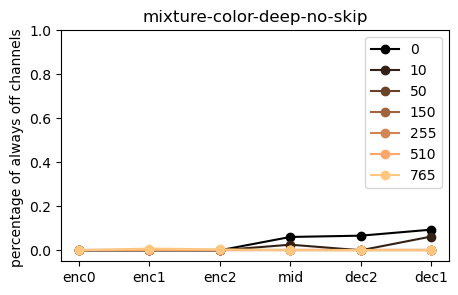

In [32]:
f, axs = plt.subplots(1, len(groups), figsize = ( len(groups)*5, 3) )

j = 0
for group in groups:
    off_channels = {}
    for sig in sigmas:
        off_channels[sig] = []
        k1 = 0
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            off_channels[sig].append((phi_block.sum(dim = 0) == 0).sum().item())
            k1 += l  
            
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas ))]
    
    c = 0
    for sig in sigmas:    
        axs.plot(block_names[group], torch.tensor(off_channels[sig])/torch.tensor(layers[group]), '-o', color = plot_colors[c],  label = sig)
        c+= 1
    axs.set_ylabel('percentage of always off channels ');
    axs.set_ylim(-.05,1)
    axs.legend();
    axs.set_title(group);
    j += 1

mixture-color-deep-no-skip


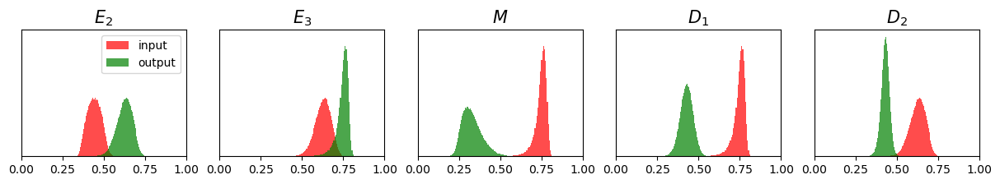

In [33]:
f,axs = plt.subplots( len(groups),len(layers[group])-1, figsize = ((len(layers[group])-1) *3, len(groups)*2 ) , 
                     sharey=True,sharex=True)
sig = 50
c = 0
for group in groups:
    k1 = 0
    all_participation_ratio = []
    for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            all_participation_ratio.append(participation_ratio_dataset(phi_block))
            k1 += l  
            # print( 'Number of channels that never are activated at sigma ', sig, ': ', (phi_block.sum(dim = 0) == 0).sum().item(), )     
    
    block_pairs = {'$E_2$': (0,1) , 
              '$E_3$': (1,2), 
              '$M$': (2,3), 
              '$D_1$': (2,4),
              '$D_2$':(1,5)}
    plt.rc('xtick', labelsize=12)       
    r = 0
    for b, pairs in block_pairs.items():
        # f, ax = plt.subplots(1,1, figsize = (3,2))
        
        axs[r].hist( all_participation_ratio[pairs[0]] ,alpha = .7, color='red', label = 'input', density=True, bins=100)
        axs[r].hist( all_participation_ratio[pairs[1]] ,alpha = .7, color='green', label = 'output', density=True, bins=100 )
        axs[r].set_title(b, fontsize=15 );
        # ax.set_xlabel('participation ratio', fontsize=15 );
        axs[r].set_xlim(0,1)
        axs[r].set_yticks([])
        axs[r].set_yticks([])    
        axs[0].legend();
        r += 1
    plt.savefig('../results/participation_ratios_unet_hist_bedroom.pdf',bbox_inches='tight')    
    print(group)    
    c += 1

## How does channel sparsity change at different noise levels and for different images? 

Mid block: On average, representation becomes more dense with noise level. 


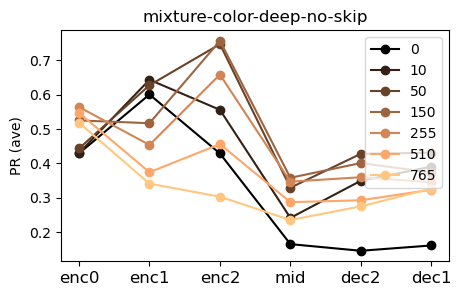

In [34]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(a_bars[group ].keys()))]
f, axs = plt.subplots(1, len(groups), figsize = ( len(groups)*5, 3) , sharey=True)

j = 0
for group in groups:
    c = 0
    for sig in sigmas:
        k1 = 0
        all_participation_ratio_mean = []
        for l in layers[group]: 
                phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
                all_participation_ratio_mean.append(participation_ratio_dataset(phi_block).mean() )
                k1 += l  
        
        axs.plot(block_names[group], all_participation_ratio_mean, '-o', color = plot_colors[c],  label = sig)
        axs.set_title(group)
        c+= 1
    j +=1
axs.set_ylabel('PR (ave)');
axs.legend();
 

## Track change in sparsity across blocks for each image

In [35]:
group = 'mixture-color-deep-no-skip'


In [36]:
a_bars_cat_prs = {}
for sig in sigmas :
    a_bars_cat = torch.cat(a_bars[group][sig] )
    
    a_bars_cat_prs[sig] = []
    k1 = 0
    
    for l in layers[group]: 
        phi_block = a_bars_cat[:,k1:k1 + l]
        a_bars_cat_prs[sig].append(participation_ratio_dataset(phi_block) )
        k1 += l  
    

lowest PR in  mid


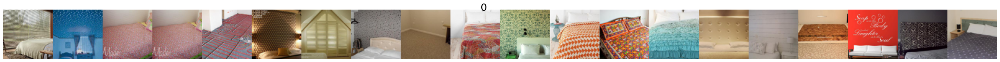

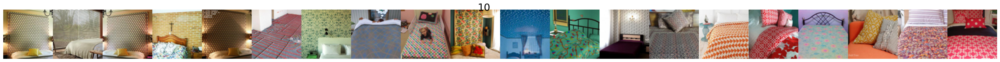

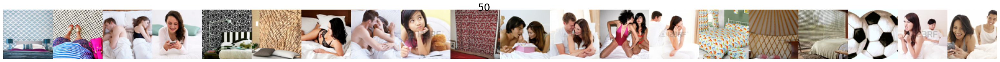

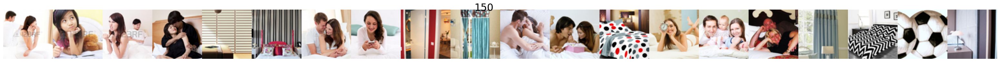

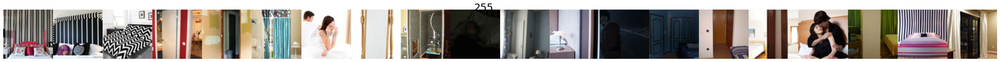

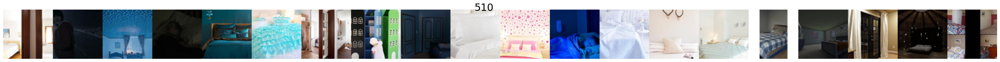

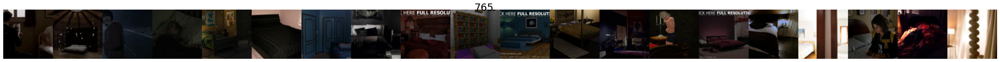

highest PR in  mid


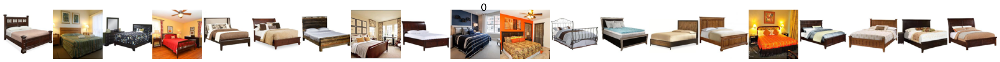

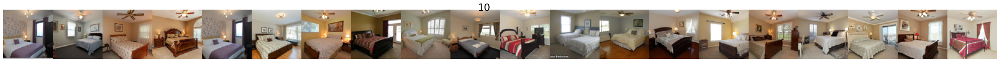

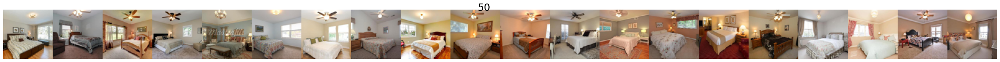

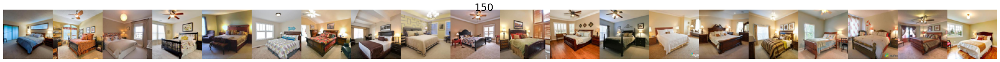

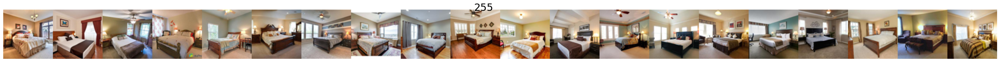

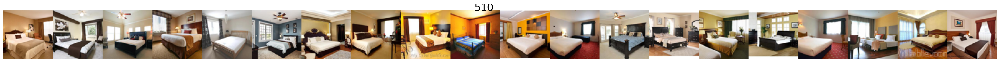

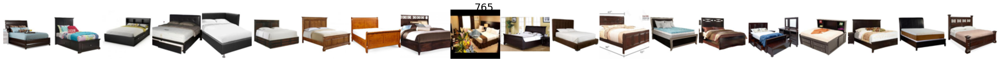

In [37]:

b = 3
print( 'lowest PR in ' , block_names[group][b])
for sig in sigmas:
    ids = a_bars_cat_prs[sig][b].sort()[1]
    show_im_grid(train_sets[ids[0:20] ], n_columns=20 ,label = sig)

print( 'highest PR in ' , block_names[group][b] )
for sig in sigmas:
    ids = a_bars_cat_prs[sig][b].sort()[1]  
    show_im_grid(train_sets[ids[-20::] ], n_columns=20 ,label = sig)

lowest PR in  dec1 at sigma:  150


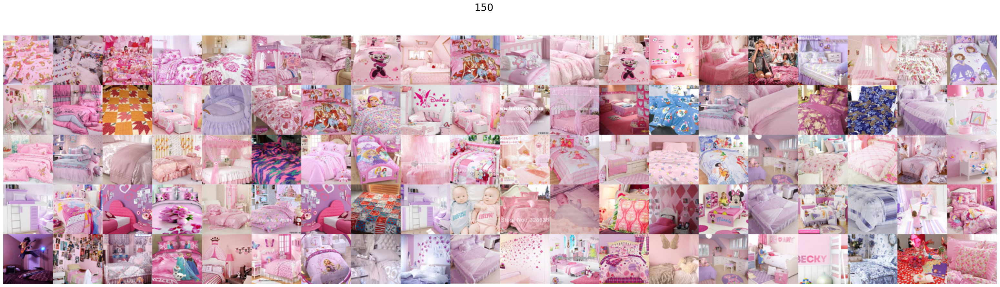

highest PR in  dec1 at sigma:  150


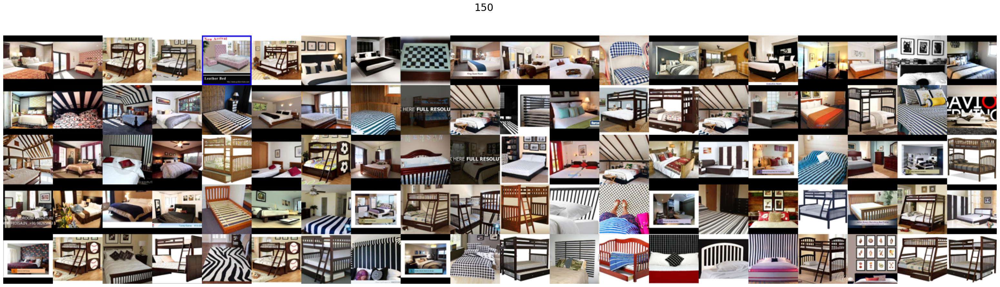

In [38]:

b = 5
sig = 150

print( 'lowest PR in ' , block_names[group][b], 'at sigma: ', sig)
ids = a_bars_cat_prs[sig][b].sort()[1]
show_im_grid(train_sets[ids[0:100] ], n_columns=20 ,label = sig)

print( 'highest PR in ' , block_names[group][b], 'at sigma: ', sig)
ids = a_bars_cat_prs[sig][b].sort()[1]  
show_im_grid(train_sets[ids[-100::] ], n_columns=20 ,label = sig)

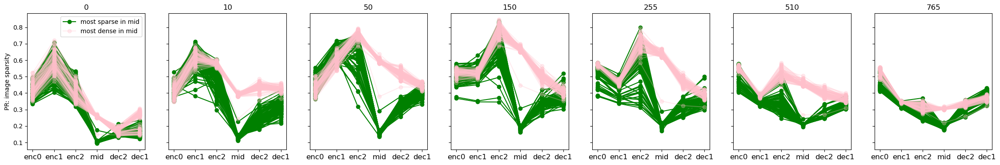

In [39]:
group = 'mixture-color-deep-no-skip'


f, axs = plt.subplots(1,len(sigmas), figsize= (len(sigmas)*4, 4 ), sharey=True)
i = 0
for sig in sigmas :
    a_bars_cat = torch.cat(a_bars[group][sig] )
    
    a_bars_cat_prs = []
    k1 = 0
    
    for l in layers[group]: 
        phi_block = a_bars_cat[:,k1:k1 + l]
        a_bars_cat_prs.append(participation_ratio_dataset(phi_block) )
        k1 += l  
    
    
    ids = a_bars_cat_prs[3].sort()[1] # sort based on the mid block PR 
    
    for im_n in ids[0:100] :
        axs[i].plot(block_names[group], torch.stack([a_bars_cat_prs[l][im_n] for l in range(len(a_bars_cat_prs)) ]),'-o', color='green')
        
    axs[i].plot(block_names[group], torch.stack([a_bars_cat_prs[l][0] for l in range(len(a_bars_cat_prs)) ]),'-o', color='green', alpha = 1, label = 'most sparse in mid')
    
    for im_n in ids[-100:] :
        axs[i].plot(block_names[group], torch.stack([a_bars_cat_prs[l][im_n] for l in range(len(a_bars_cat_prs)) ]),'-o', color='pink', alpha = .3)
    
    
    axs[i].plot(block_names[group], torch.stack([a_bars_cat_prs[l][-1] for l in range(len(a_bars_cat_prs)) ]),'-o', color='pink', alpha = .3, label = 'most dense in mid')
    axs[i].set_title(sig)
    i += 1
axs[0].legend()
axs[0].set_ylabel('PR: image sparsity');


dog images are the most dense in mid block. Is it becuase there is more of them in the training dataset? Maybe imagenet is not very good for this puropse, becuase of the imbalance in the classes. Use MS COCO dataset 

# Channel selectivity

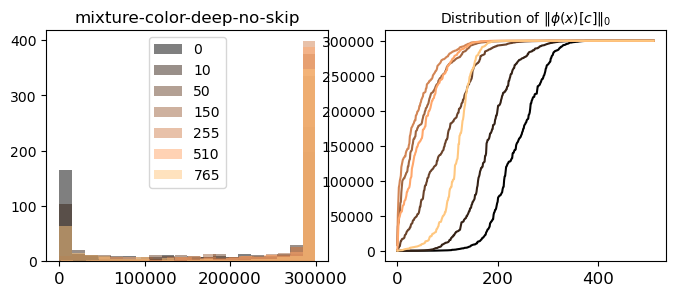

In [40]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas ))]


for group in groups:
    f, axs = plt.subplots(1,2, figsize = (8,3))
    i = 0
    for sig in sigmas:
        axs[0].hist(torch.cat(phis[group][sig]).norm(0, dim = 0).cpu(), alpha = .5, label = sig, bins = 20, color=plot_colors[i]);
        axs[1].plot(torch.cat(phis[group][sig]).norm(0, dim = 0).cpu().sort()[0], label = sig, color=plot_colors[i]);    
        axs[0].legend()
        i += 1
    axs[1].set_title('Distribution of $\Vert \phi(x)[c] \Vert_0$', fontsize = 10)   ;
    axs[0].set_title(group )   ;
    # print(group)    

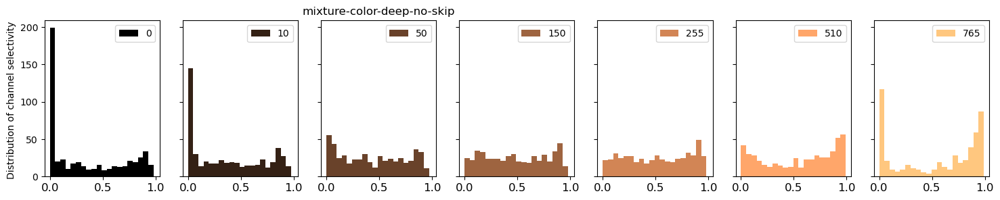

In [41]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(a_bars[group ].keys()))]

for group in groups:
    f, axs = plt.subplots(1,len(sigmas) , figsize = (18,3), sharey=True, sharex=True)
    i = 0 
    for sig in sigmas:
        axs[i].hist(ch_selectivity[group][sig], alpha = 1, label = sig, bins = 20, color = plot_colors[i]);   
        axs[i].legend()    
        i += 1
    axs[0].set_ylabel('Distribution of channel selectivity ')   ;
    axs[2].set_title(group )

        
    # print(group)

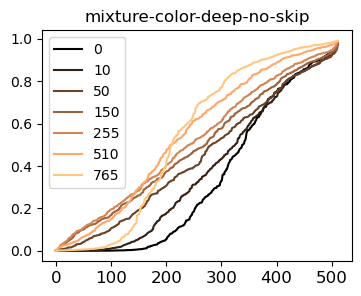

In [42]:
f, axs = plt.subplots(1,len(groups) , figsize = (4*len(groups),3), sharey=True, sharex=False)
c = 0
for group in groups:
    j = 0
    for sig in sigmas:
        axs.plot(ch_selectivity[group][sig].sort()[0], label = sig, color = plot_colors[j]);    
        
        j += 1
    axs.set_title(group)        
    c += 1
axs.legend();        
    

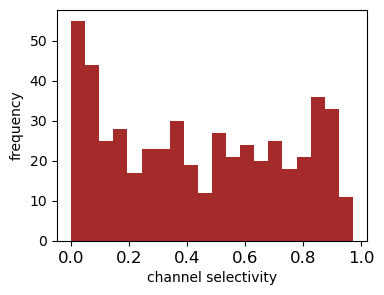

In [80]:
sig = 50
f, axs = plt.subplots(1,1 , figsize = (4,3), sharey=True, sharex=True)
axs.hist(ch_selectivity[group][sig], alpha = 1, label = sig, bins = 20, color = 'brown');   
axs.set_xlabel('channel selectivity')   ;
axs.set_ylabel('frequency')   ;
plt.savefig( '../results/ch_selectivity_bedroom_hist.pdf',bbox_inches='tight')    


## channel selectivity at other blocks

In [43]:

ch_selectivity_all_scales = {}
for group in groups:
    ch_selectivity_all_scales[group] ={}
    for sig in sigmas:    
        ch_selectivity_all_scales[group][sig] = []
        k1 = 0
    
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            
            # ch_selectivity_all_scales[group][sig].append(participation_ratio_dataset(phi_block.T).cpu())
            ch_selectivity_all_scales[group][sig].append(torch.nan_to_num(participation_ratio_dataset(phi_block.T).cpu(), nan = 0.0))
            k1 += l     
            



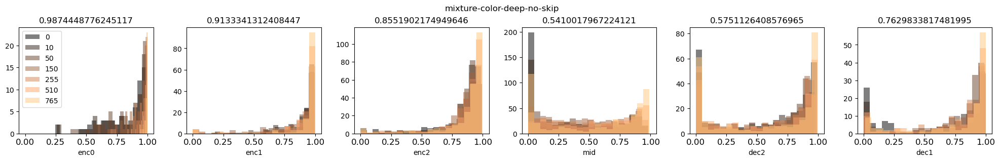

In [44]:
for group in groups:
    f, axs = plt.subplots(1 ,6, figsize = (20, 3))
    f.suptitle(group)
    plt.tight_layout()
    
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas))]
    
    for b in range(len(layers[group])):
        for i, sig in zip(range(len(sigmas)),sigmas):        
            axs[b].hist(ch_selectivity_all_scales[group][sig][b].flatten(), bins = 20, color= plot_colors[i] , alpha = .5, label = sig)
        axs[b].set_xlim(-.05, 1.05)
        axs[b].set_xlabel(block_names[group][b])
        axs[b].set_title(ch_selectivity_all_scales[group][sig][b].mean().item())
    
    axs[0].legend();


# 4) Specialized vs. Common channels

channels selectivity:  0.018157977610826492


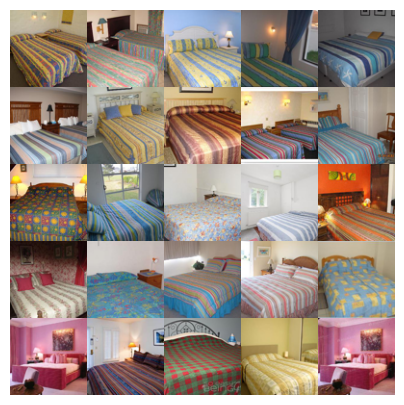

channels selectivity:  0.015323936939239502


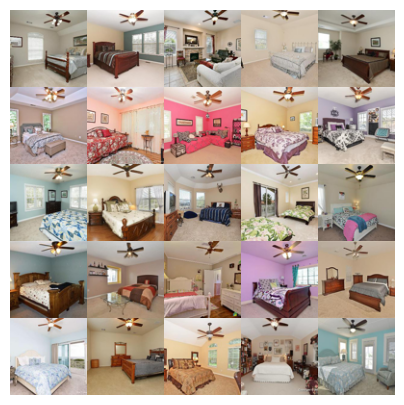

channels selectivity:  0.053808070719242096


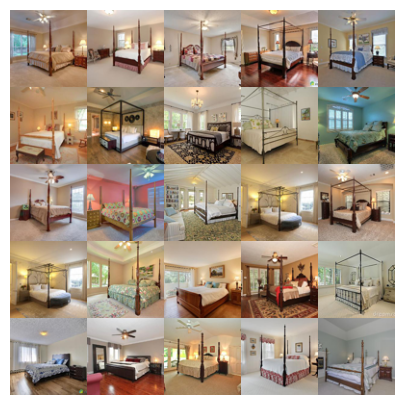

channels selectivity:  0.3645159900188446


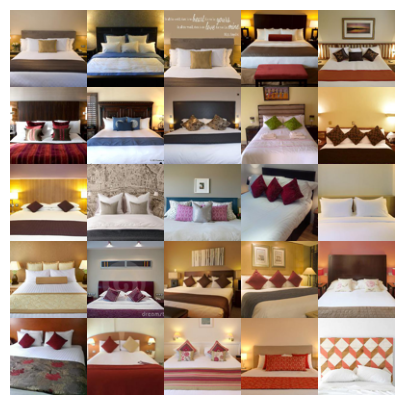

In [61]:
## channels shown in the paper: [171, 286, 76, 485, 168, 480,383 , 355, 170, 422, 190, 463, 110] ,
#pr:[ 0.00657, 0.013, 0.0116, 0.009, 0.0098, 0.007,0.0181, 0.015, 0.014, 0.0538, 0.36, ,  0.085]
sig = 50
group  = 'mixture-color-deep-no-skip'


for ch_n in [ 383 , 355, 422, 190] :
    # ch_n = ids_selectivity_sorted[group][sig][i] 
    print('channels selectivity: ', ch_selectivity[group][sig][ch_n].item()  )

    p = min(25, round(ch_selectivity[group][sig][ch_n].item() * train_sets.shape[0]))
    show_im_grid(train_sets[torch.cat(phis[group][sig])[:,ch_n].cpu().sort(descending = True)[1][0:p]], 
                 n_columns= 5 , im_size=1, save_name= '../results/channel_'+str(ch_n)+'_bedroom.png', dpi = 50)
    # show_im_grid(torch.cat(test_sets)[torch.cat(phis[50])[:,77].cpu().sort(descending = True)[1][0:25]], n_columns= 5 , im_size=1, return_image=False)
    # plt.savefig( '../results/channel77.png',bbox_inches='tight')  

## Distribution of $\phi$ within each channel 


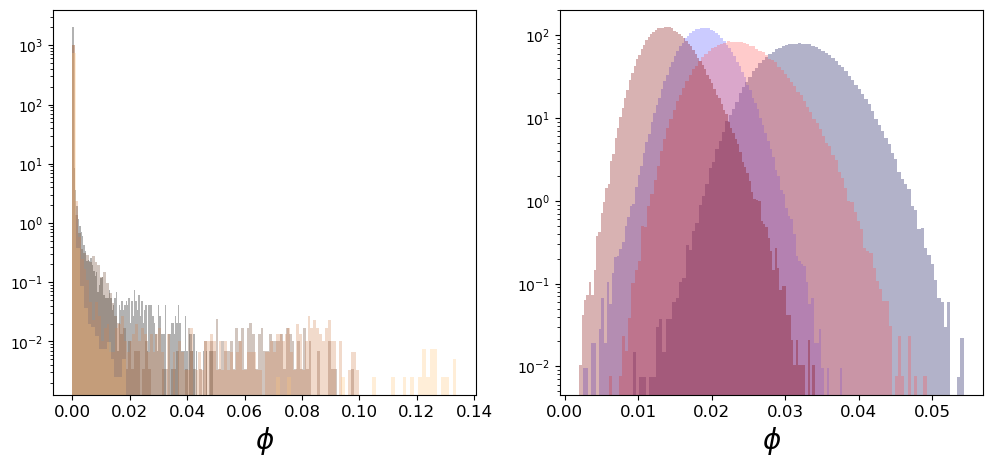

In [81]:
sig = 150 
f, axs = plt.subplots(1,2, figsize = (12,5), sharex= False, sharey = False)
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, 4 )]
i = 0
for id in ids_selectivity_sorted[group][sig][-4::]: 
    axs[0].hist(   torch.cat(phis[group][sig]).cpu()[:, id ], bins = 100, alpha = .3 , density = True, color = plot_colors[i], label = id) ;
    i+=1
# axs[0].set_title('distribution of $\phi$ in 10 specialized channels',fontsize = 15 )
plot_colors = [scale_colormap(i) for i in np.linspace(0, 1, 4 )]
i = 0

for id in ids_selectivity_sorted[group][sig][0:4]: 
    axs[1].hist(   torch.cat(phis[group][sig]).cpu()[:, id ], bins = 100, alpha = .3 , density = True, color =plot_colors[i], label = id) ;
    i+=1

# axs[1].set_title('distribution of $\phi$ in 4 common channels' ,fontsize = 15)
# axs[0].legend()
# axs[1].legend();
axs[0].set_xlabel('$\phi$',fontsize = 20)
axs[1].set_xlabel('$\phi$',fontsize = 20)

axs[0].set_yscale('log')
axs[1].set_yscale('log')
plt.savefig( '../results/marginals_bedroom.pdf',bbox_inches='tight')  

Text(0.5, 1.0, 'joint density b/w two common channels')

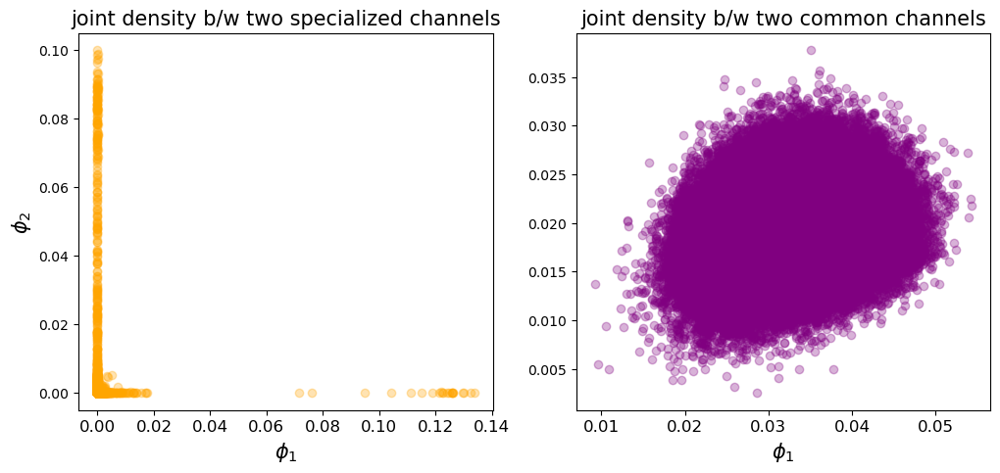

In [63]:
sig = 150 
f, axs = plt.subplots(1,2, figsize = (12,5), sharex= False, sharey = False)

axs[0].scatter(torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][-1:] ],
               torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][-2:-1] ], 
               alpha = .3 ,  label = id ,color = 'orange') ;

axs[1].scatter(torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][0:1] ],
               torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][1:2] ], 
               alpha = .3 ,  label = id,  color = 'purple' );
axs[0].set_xlabel('$\phi_1$', fontsize = 15)
axs[1].set_xlabel('$\phi_1$', fontsize = 15)
axs[0].set_ylabel('$\phi_2$', fontsize = 15)
axs[0].set_title('joint density b/w two specialized channels', fontsize = 15)
axs[1].set_title('joint density b/w two common channels', fontsize = 15)


torch.Size([100, 512, 10, 10])


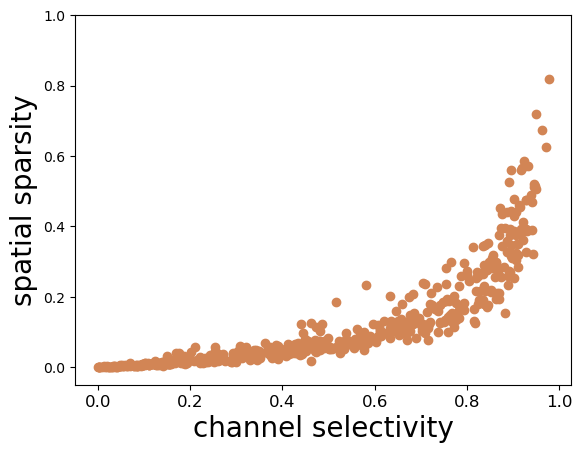

In [82]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas) )]
i = 4
sig = 150
group  = 'mixture-color-deep-no-skip'
clean_inp =train_sets[0:100] 
# clean_inp = test_sets[0]

noisy_inp =clean_inp + torch.randn_like(clean_inp) * sig/255
# _ , acts = get_channel_means(denoisers[group], noisy_inp, return_activations=True )

acts = get_activations_unconditional(denoisers[group], noisy_inp, noGrad=True)
print(acts[3].shape)
# spatial sparsity 
spatial_sparsity = []
for c in range(layers[group][3]):
    spatial_sparsity.append(torch.nan_to_num(participation_ratio_dataset(acts[3][:,c].flatten(start_dim = 1)), nan=0).mean())


plt.scatter(  ch_selectivity[group][sig] , torch.stack(spatial_sparsity).flatten().cpu() , color = plot_colors[i]) 
i += 1
# plt.title(group)
plt.ylim(-.05,1)
plt.xlabel('channel selectivity', fontsize = 20 )
plt.ylabel('spatial sparsity', fontsize = 20);
plt.savefig( '../results/ch_selectivity_spatial_sparsity_bedroom.pdf',bbox_inches='tight')  

torch.Size([100, 512, 10, 10])
torch.Size([100, 512, 10, 10])
torch.Size([100, 512, 10, 10])
torch.Size([100, 512, 10, 10])
torch.Size([100, 512, 10, 10])
torch.Size([100, 512, 10, 10])
torch.Size([100, 512, 10, 10])


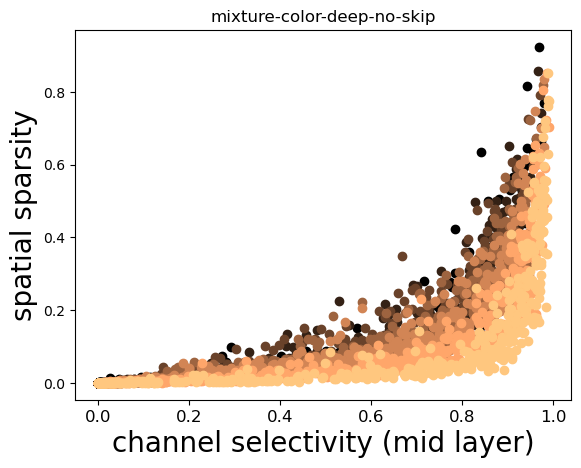

In [68]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas) )]
i = 0

group  = 'mixture-color-deep-no-skip'
for sig in sigmas:
    clean_inp = train_sets[0:100]
    # clean_inp = test_sets[0]
    
    noisy_inp =clean_inp + torch.randn_like(clean_inp) * sig/255
    # _ , acts = get_channel_means(denoisers[group], noisy_inp, return_activations=True )
    
    acts = get_activations_unconditional(denoisers[group], noisy_inp, noGrad=True)
    print(acts[3].shape)
    # spatial sparsity 
    spatial_sparsity = []
    for c in range(layers[group][3]):
        spatial_sparsity.append(torch.nan_to_num(participation_ratio_dataset(acts[3][:,c].flatten(start_dim = 1)), nan=0).mean())
    
    
    plt.scatter(  ch_selectivity[group][sig] , torch.stack(spatial_sparsity).flatten().cpu() , color = plot_colors[i]) 
    i += 1
    plt.title(group)
plt.xlabel('channel selectivity (mid layer)', fontsize = 20 )
plt.ylabel('spatial sparsity', fontsize = 20);


## PCA of channel responses
specializd channels are more concentrated \
common channels are higher dimensional 

In [69]:
from sklearn.decomposition import PCA


In [70]:
group  = 'mixture-color-deep-no-skip'

sig = 150

clean_inp = train_sets[0:1000]
# clean_inp = test_sets[0]

noisy_inp =clean_inp + torch.randn_like(clean_inp) * sig/255
# _ , acts = get_channel_means(denoisers[group], noisy_inp, return_activations=True )

acts = get_activations_unconditional(denoisers[group], noisy_inp, noGrad=True)

In [71]:
# Create pca model

pca_model = PCA(n_components=64)
# Fit model
PC = []
exp_var = []
for i in range(layers[group][3]):
    PC.append(torch.tensor(pca_model.fit_transform(acts[3][:, i].flatten(start_dim = 1).cpu().T )) )
    exp_var.append(torch.tensor(pca_model.explained_variance_ratio_) )
PC = torch.stack(PC).unsqueeze(1)


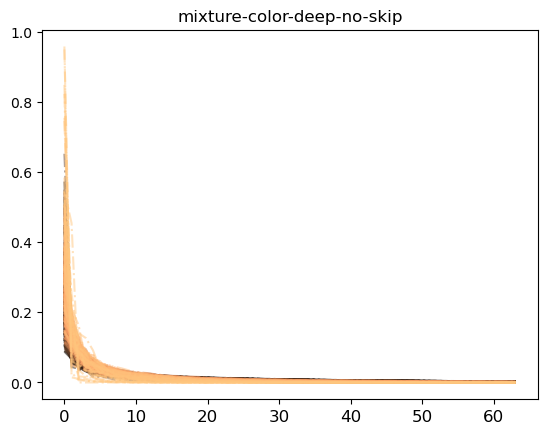

In [72]:
colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1,layers[group][3])]

for i in range(layers[group][3]):
    plt.plot(torch.stack(exp_var)[ids_selectivity_sorted[group][150]][i,:], '-.',color = plot_colors[i], alpha = .5)
plt.title(group);

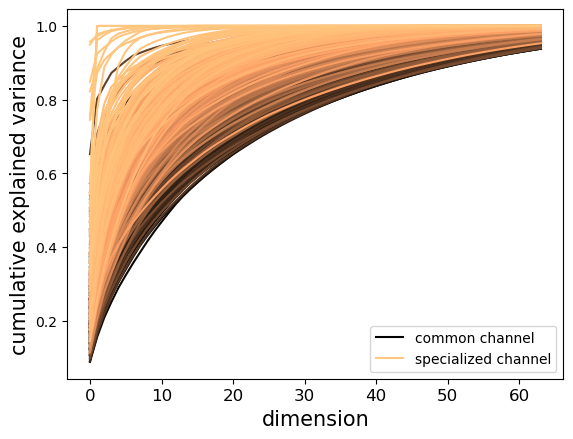

In [79]:
### 
colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1,512)]

plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[0,:] , color = plot_colors[0], label = 'common channel' ) 

for i in range(1,512):
    plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[i,:] , color = plot_colors[i] ) 

# for i in range(-100,-1):
    # plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[i,:] , color = plot_colors[i] ) 

plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[-1,:] , color = plot_colors[-1], label = 'specialized channel' ) 

plt.legend()
plt.xlabel('dimension', fontsize = 15)
plt.ylabel('cumulative explained variance', fontsize = 15)
plt.savefig('../results/cum_var_bedroom.png', bbox_inches='tight')   